In [1]:
import pandas as pd
import numpy as np
# # step one, dannce alignment
import os
import sys
sys.path.append(os.path.abspath('../..'))
# from utlis.sync_utlis.mini_dannce_sync import sync_videos, align_miniscope_to_sixcam


rec_path = '/data/big_rim/rsync_dcc_sum/Oct3V1/2024_10_25/20241002PMCr2_17_05'

hdf5_file_path = os.path.join(rec_path, 'MIR_Aligned/aligned_predictions_with_ca_and_dF_F.h5')

# Load the DataFrame from the HDF5 file
df_merged_with_dF_F = pd.read_hdf(hdf5_file_path, key='df')

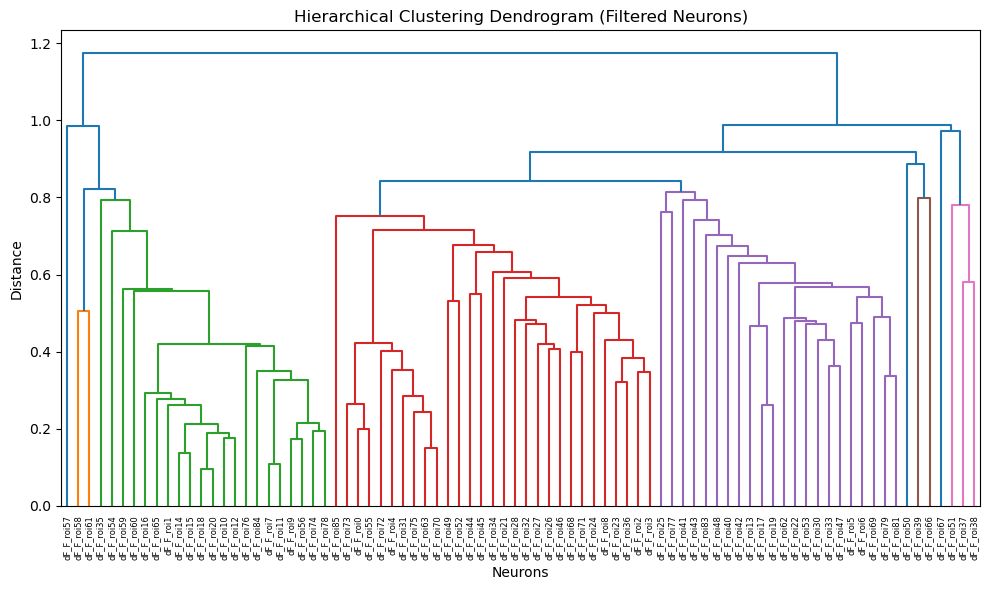

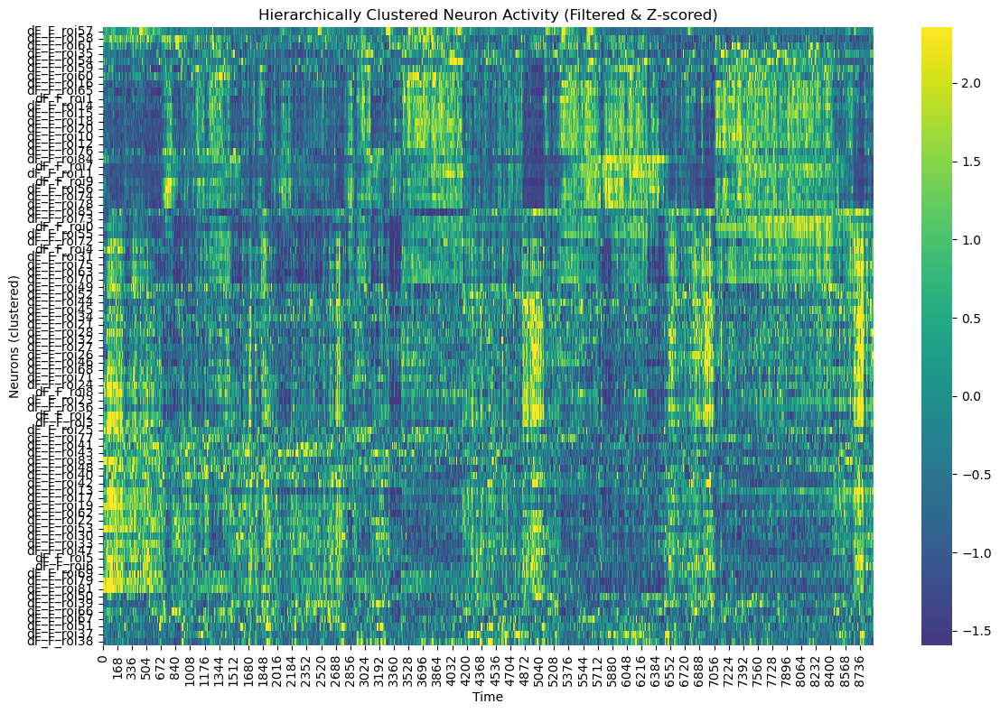

In [2]:
#added the filter low variance step
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.cluster.hierarchy import linkage, dendrogram, leaves_list
from scipy.stats import zscore

# Assuming df_merged_with_dF_F is already loaded
# Extract columns that correspond to neurons
neuron_columns = [col for col in df_merged_with_dF_F.columns if col.startswith('dF_F_roi')]
neuron_activity = df_merged_with_dF_F[neuron_columns].values  # shape: (timepoints, neurons)

# Transpose to get shape: (neurons, timepoints)
neuron_activity = neuron_activity.T

# Step to drop low-variance neurons (reduce false positives)
neuron_variances = np.var(neuron_activity, axis=1)  # Variance for each neuron
threshold = np.percentile(neuron_variances, 5)      # Keep top 95% variance
high_variance_indices = neuron_variances > threshold  # Mask for neurons to keep

# Filter neuron activity and neuron column names
neuron_activity_filtered = neuron_activity[high_variance_indices, :]
filtered_neuron_columns = [col for i, col in enumerate(neuron_columns) if high_variance_indices[i]]

# Optional: Z-score normalization along each neuron's time course
neuron_activity_normalized = zscore(neuron_activity_filtered, axis=1)
# 'correlation' is often a good metric for neural activity, but you can try 'euclidean'.
# 'average' linkage is a common choice, but feel free to experiment (e.g., 'ward', 'complete').
# Perform hierarchical clustering on the filtered and normalized data
Z = linkage(neuron_activity_normalized, method='average', metric='correlation')

# Plot the dendrogram to visualize the hierarchical structure
plt.figure(figsize=(10, 6))
dendrogram(Z, labels=filtered_neuron_columns, leaf_rotation=90)
plt.title('Hierarchical Clustering Dendrogram (Filtered Neurons)')
plt.xlabel('Neurons')
plt.ylabel('Distance')
plt.tight_layout()
plt.show()

# Get the order of the leaves (neurons) from the dendrogram
neuron_order = leaves_list(Z)

# Reorder filtered and normalized neuron activity and neuron column names
neuron_activity_ordered = neuron_activity_normalized[neuron_order, :]
ordered_neuron_columns = [filtered_neuron_columns[i] for i in neuron_order]

# Plot a heatmap of the clustered neurons
plt.figure(figsize=(12, 8))
sns.heatmap(neuron_activity_ordered, cmap='viridis', center=0, robust=True)
plt.title('Hierarchically Clustered Neuron Activity (Filtered & Z-scored)')
plt.xlabel('Time')
plt.ylabel('Neurons (clustered)')
plt.yticks(np.arange(len(ordered_neuron_columns)) + 0.5, ordered_neuron_columns, rotation=0)
plt.tight_layout()
plt.show()


Columns in df_new: ['com_x', 'com_y', 'com_z', 'kp1_x', 'kp1_y', 'kp1_z', 'kp2_x', 'kp2_y', 'kp2_z', 'kp3_x', 'kp3_y', 'kp3_z', 'kp4_x', 'kp4_y', 'kp4_z', 'kp5_x', 'kp5_y', 'kp5_z', 'kp6_x', 'kp6_y', 'kp6_z', 'kp7_x', 'kp7_y', 'kp7_z', 'kp8_x', 'kp8_y', 'kp8_z', 'kp9_x', 'kp9_y', 'kp9_z', 'kp10_x', 'kp10_y', 'kp10_z', 'kp11_x', 'kp11_y', 'kp11_z', 'kp12_x', 'kp12_y', 'kp12_z', 'kp13_x', 'kp13_y', 'kp13_z', 'kp14_x', 'kp14_y', 'kp14_z', 'kp15_x', 'kp15_y', 'kp15_z', 'kp16_x', 'kp16_y', 'kp16_z', 'kp17_x', 'kp17_y', 'kp17_z', 'kp18_x', 'kp18_y', 'kp18_z', 'kp19_x', 'kp19_y', 'kp19_z', 'kp20_x', 'kp20_y', 'kp20_z', 'kp21_x', 'kp21_y', 'kp21_z', 'kp22_x', 'kp22_y', 'kp22_z', 'calcium_roi0', 'calcium_roi1', 'calcium_roi2', 'calcium_roi3', 'calcium_roi4', 'calcium_roi5', 'calcium_roi6', 'calcium_roi7', 'calcium_roi8', 'calcium_roi9', 'calcium_roi10', 'calcium_roi11', 'calcium_roi12', 'calcium_roi13', 'calcium_roi14', 'calcium_roi15', 'calcium_roi16', 'calcium_roi17', 'calcium_roi18', 'calciu

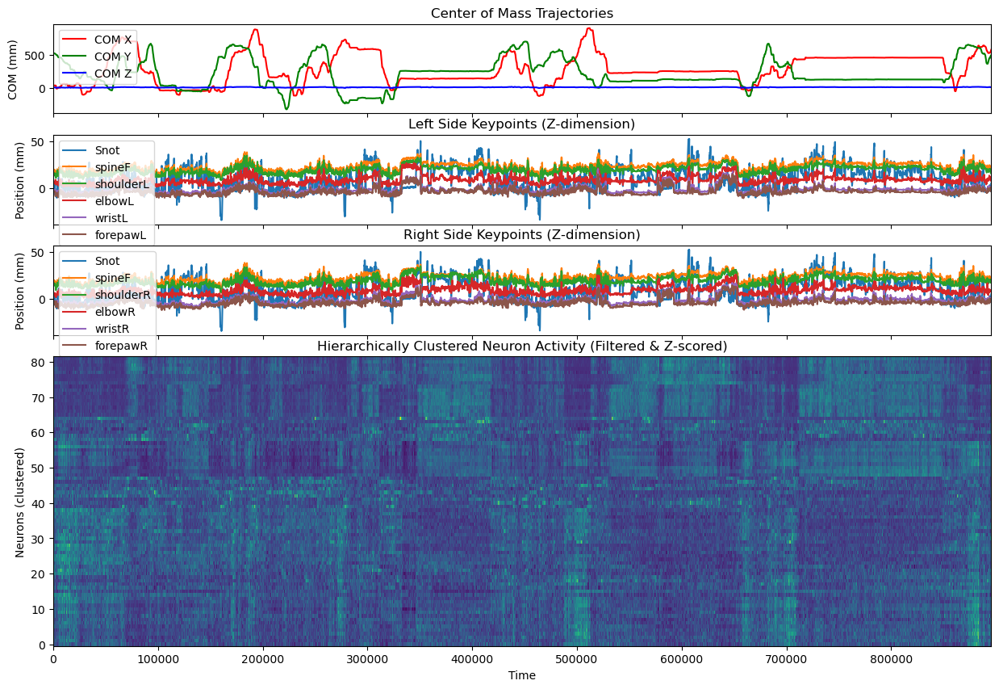

In [18]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from scipy.cluster.hierarchy import linkage, leaves_list
# %matplotlib inline


df_new = df_merged_with_dF_F
# Example location indices and labels
location_indices_left = [3, 4, 12, 11, 10, 9]
location_labels_left = {3: "Snot", 4: "spineF", 12: "shoulderL", 11: "elbowL", 10: "wristL", 9: "forepawL"}

location_indices_right = [3, 4, 16, 15, 14, 13]
location_labels_right = {3: "Snot", 4: "spineF", 16: "shoulderR", 15: "elbowR", 14: "wristR", 13: "forepawR"}


time = df_new.index  # Assuming time is the index
print("Columns in df_new:", df_new.columns.tolist())  # Debug info

fig = plt.figure(figsize=(15, 10))
gs = fig.add_gridspec(nrows=5, ncols=1, height_ratios=[1.5, 1.5, 1.5, 1.5, 3])

###########################################
# Top Plot: COM trajectories
###########################################
ax1 = fig.add_subplot(gs[0, 0])
if 'com_x' in df_new.columns and 'com_y' in df_new.columns and 'com_z' in df_new.columns:
    ax1.plot(time, df_new['com_x'], color='red', label='COM X')
    ax1.plot(time, df_new['com_y'], color='green', label='COM Y')
    ax1.plot(time, df_new['com_z'], color='blue', label='COM Z')
    ax1.set_ylabel('COM (mm)')
    ax1.set_title('Center of Mass Trajectories')
    ax1.legend(loc='upper left')
else:
    print("COM columns not found (com_x, com_y, com_z). Check your DataFrame.")
ax1.tick_params(labelbottom=False)  # Remove x-axis labels

###########################################
# Second Plot: Left Side Keypoints (Z-dim)
###########################################
ax2 = fig.add_subplot(gs[1, 0], sharex=ax1)
ax2.set_title('Left Side Keypoints (Z-dimension)')
for idx in location_indices_left:
    z_col = f'kp{idx}_z'
    if z_col in df_new.columns:
        ax2.plot(time, df_new[z_col], label=location_labels_left[idx])
    else:
        print(f"Warning: {z_col} not found for idx={idx}")
ax2.set_ylabel('Position (mm)')
ax2.legend(loc='upper left')
ax2.tick_params(labelbottom=False)  # Remove x-axis labels
###########################################
# Third Plot: Right Side Keypoints (Z-dim)
###########################################
ax3 = fig.add_subplot(gs[2, 0], sharex=ax1)
ax3.set_title('Right Side Keypoints (Z-dimension)')
for idx in location_indices_right:
    z_col = f'kp{idx}_z'
    if z_col in df_new.columns:
        ax3.plot(time, df_new[z_col], label=location_labels_right[idx])
    else:
        print(f"Warning: {z_col} not found for idx={idx}")
ax3.set_ylabel('Position (mm)')
ax3.legend(loc='upper left')
ax3.tick_params(labelbottom=False)  # Remove x-axis labels




###########################################
# Fourth Plot: Heatmap without Colorbar
###########################################
if 'neuron_activity_normalized' in globals() and neuron_activity_normalized is not None:
    Z = linkage(neuron_activity_normalized, method='ward')  # Hierarchical clustering
    neuron_order = leaves_list(Z)  # Get the order of the leaves
    neuron_activity_ordered = neuron_activity_normalized[neuron_order, :]
    ordered_neuron_columns = [filtered_neuron_columns[i] for i in neuron_order]

    # Time axis and neuron indices
    time_values = time  # Assuming time is the index or numpy array
    neuron_indices = np.arange(len(neuron_activity_ordered))

    # Create heatmap with pcolormesh
    ax4 = fig.add_subplot(gs[3:5, 0], sharex=ax1)  # Share x-axis
    ax4.pcolormesh(
        time_values, neuron_indices, neuron_activity_ordered,
        cmap='viridis', shading='auto'
    )

    # Heatmap labels
    ax4.set_title('Hierarchically Clustered Neuron Activity (Filtered & Z-scored)')
    ax4.set_ylabel('Neurons (clustered)')
    ax4.set_xlabel('Time')
else:
    print("Neuron activity data not found. Skipping heatmap plot.")
    ax4 = fig.add_subplot(gs[3:5, 0])
    ax4.text(0.5, 0.5, 'No neuron activity data available.',
             transform=ax4.transAxes, ha='center', va='center')



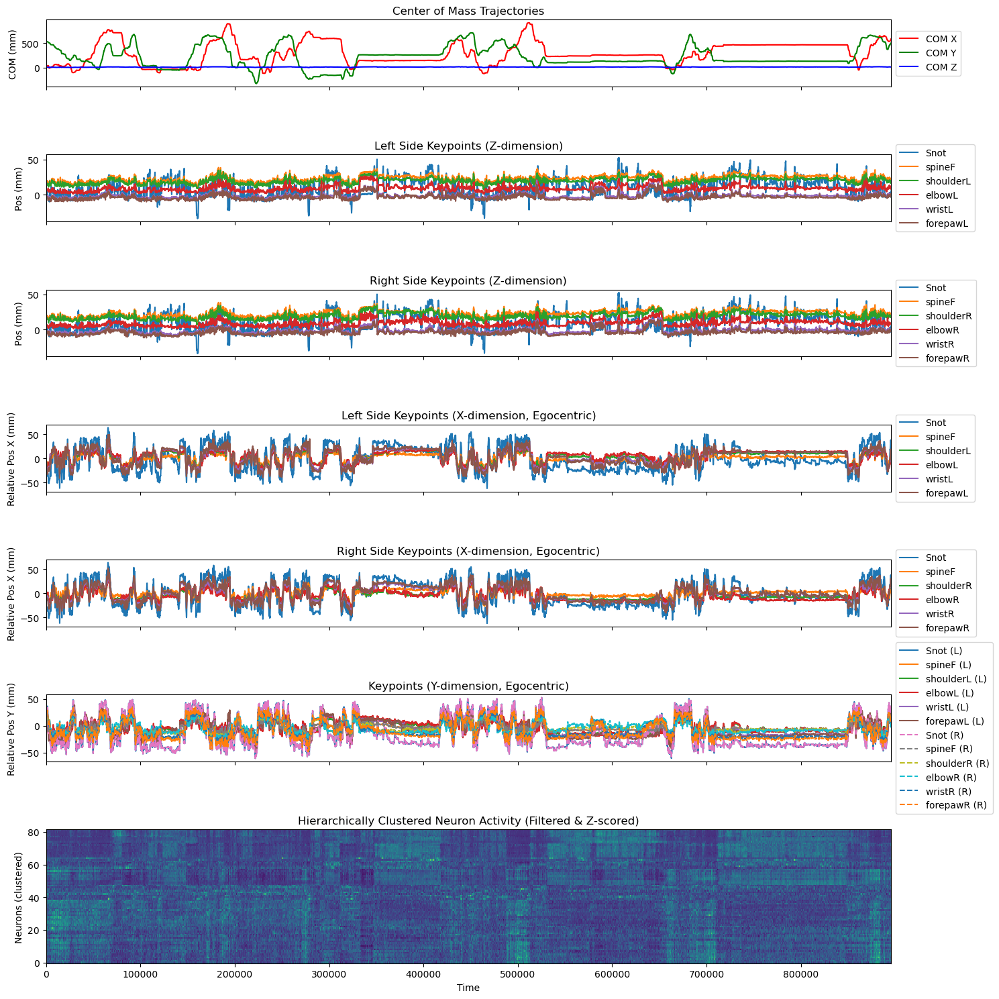

In [23]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from scipy.cluster.hierarchy import linkage, leaves_list

df_new = df_merged_with_dF_F
# Example location indices and labels
location_indices_left = [3, 4, 12, 11, 10, 9]
location_labels_left = {3: "Snot", 4: "spineF", 12: "shoulderL", 11: "elbowL", 10: "wristL", 9: "forepawL"}

location_indices_right = [3, 4, 16, 15, 14, 13]
location_labels_right = {3: "Snot", 4: "spineF", 16: "shoulderR", 15: "elbowR", 14: "wristR", 13: "forepawR"}

time = df_new.index  # Assuming time is the index

fig = plt.figure(figsize=(15, 15))
gs = fig.add_gridspec(nrows=7, ncols=1, height_ratios=[1.5, 1.5, 1.5, 1.5, 1.5, 1.5, 3])

###########################################
# Top Plot: COM trajectories
###########################################
ax1 = fig.add_subplot(gs[0, 0])
if 'com_x' in df_new.columns and 'com_y' in df_new.columns and 'com_z' in df_new.columns:
    ax1.plot(time, df_new['com_x'], color='red', label='COM X')
    ax1.plot(time, df_new['com_y'], color='green', label='COM Y')
    ax1.plot(time, df_new['com_z'], color='blue', label='COM Z')
    ax1.set_ylabel('COM (mm)')
    ax1.set_title('Center of Mass Trajectories')
else:
    print("COM columns not found (com_x, com_y, com_z). Check your DataFrame.")
ax1.tick_params(labelbottom=False)
# Move the legend outside the plot
ax1.legend(loc='center left', bbox_to_anchor=(1, 0.5))

###########################################
# Second Plot: Left Side Keypoints (Z-dim)
###########################################
ax2 = fig.add_subplot(gs[1, 0], sharex=ax1)
ax2.set_title('Left Side Keypoints (Z-dimension)')
for idx in location_indices_left:
    z_col = f'kp{idx}_z'
    if z_col in df_new.columns:
        ax2.plot(time, df_new[z_col], label=location_labels_left[idx])
    else:
        print(f"Warning: {z_col} not found for idx={idx}")
ax2.set_ylabel('Pos (mm)')
ax2.tick_params(labelbottom=False)
ax2.legend(loc='center left', bbox_to_anchor=(1, 0.5))

###########################################
# Third Plot: Right Side Keypoints (Z-dim)
###########################################
ax3 = fig.add_subplot(gs[2, 0], sharex=ax1)
ax3.set_title('Right Side Keypoints (Z-dimension)')
for idx in location_indices_right:
    z_col = f'kp{idx}_z'
    if z_col in df_new.columns:
        ax3.plot(time, df_new[z_col], label=location_labels_right[idx])
    else:
        print(f"Warning: {z_col} not found for idx={idx}")
ax3.set_ylabel('Pos (mm)')
ax3.tick_params(labelbottom=False)
ax3.legend(loc='center left', bbox_to_anchor=(1, 0.5))

###########################################
# Fourth Plot: Left Side Keypoints (X-dim, Egocentric)
###########################################
ax4 = fig.add_subplot(gs[3, 0], sharex=ax1)
ax4.set_title('Left Side Keypoints (X-dimension, Egocentric)')
if 'com_x' in df_new.columns:
    for idx in location_indices_left:
        x_col = f'kp{idx}_x'
        if x_col in df_new.columns:
            x_ego = df_new[x_col] - df_new['com_x']
            ax4.plot(time, x_ego, label=location_labels_left[idx])
        else:
            print(f"Warning: {x_col} not found for idx={idx}")
    ax4.set_ylabel('Relative Pos X (mm)')
else:
    print("No COM X found. Cannot compute egocentric coordinates.")
ax4.tick_params(labelbottom=False)
ax4.legend(loc='center left', bbox_to_anchor=(1, 0.5))

###########################################
# Fifth Plot: Right Side Keypoints (X-dim, Egocentric)
###########################################
ax5 = fig.add_subplot(gs[4, 0], sharex=ax1)
ax5.set_title('Right Side Keypoints (X-dimension, Egocentric)')
if 'com_x' in df_new.columns:
    for idx in location_indices_right:
        x_col = f'kp{idx}_x'
        if x_col in df_new.columns:
            x_ego = df_new[x_col] - df_new['com_x']
            ax5.plot(time, x_ego, label=location_labels_right[idx])
        else:
            print(f"Warning: {x_col} not found for idx={idx}")
    ax5.set_ylabel('Relative Pos X (mm)')
else:
    print("No COM X found. Cannot compute egocentric coordinates.")
ax5.tick_params(labelbottom=False)
ax5.legend(loc='center left', bbox_to_anchor=(1, 0.5))

###########################################
# Sixth Plot: Keypoints (Y-dim, Egocentric)
###########################################
ax6 = fig.add_subplot(gs[5, 0], sharex=ax1)
ax6.set_title('Keypoints (Y-dimension, Egocentric)')
if 'com_y' in df_new.columns:
    for idx in location_indices_left:
        y_col = f'kp{idx}_y'
        if y_col in df_new.columns:
            y_ego = df_new[y_col] - df_new['com_y']
            ax6.plot(time, y_ego, label=location_labels_left[idx] + ' (L)', linestyle='-')
        else:
            print(f"Warning: {y_col} not found for idx={idx}")

    for idx in location_indices_right:
        y_col = f'kp{idx}_y'
        if y_col in df_new.columns:
            y_ego = df_new[y_col] - df_new['com_y']
            ax6.plot(time, y_ego, label=location_labels_right[idx] + ' (R)', linestyle='--')
        else:
            print(f"Warning: {y_col} not found for idx={idx}")

    ax6.set_ylabel('Relative Pos Y (mm)')
else:
    print("No COM Y found. Cannot compute egocentric coordinates.")
ax6.tick_params(labelbottom=False)
ax6.legend(loc='center left', bbox_to_anchor=(1, 0.5))

###########################################
# Seventh Plot: Heatmap (unchanged)
###########################################
if 'neuron_activity_normalized' in globals() and neuron_activity_normalized is not None:
    Z = linkage(neuron_activity_normalized, method='ward')  # Hierarchical clustering
    neuron_order = leaves_list(Z)  # Get the order of the leaves
    neuron_activity_ordered = neuron_activity_normalized[neuron_order, :]
    ordered_neuron_columns = [filtered_neuron_columns[i] for i in neuron_order]

    time_values = time
    neuron_indices = np.arange(len(neuron_activity_ordered))

    ax7 = fig.add_subplot(gs[6, 0], sharex=ax1)
    ax7.pcolormesh(
        time_values, neuron_indices, neuron_activity_ordered,
        cmap='viridis', shading='auto'
    )
    ax7.set_title('Hierarchically Clustered Neuron Activity (Filtered & Z-scored)')
    ax7.set_ylabel('Neurons (clustered)')
    ax7.set_xlabel('Time')
else:
    print("Neuron activity data not found. Skipping heatmap plot.")
    ax7 = fig.add_subplot(gs[6, 0])
    ax7.text(0.5, 0.5, 'No neuron activity data available.',
             transform=ax7.transAxes, ha='center', va='center')

plt.tight_layout()
plt.show()


In [29]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from scipy.cluster.hierarchy import linkage, leaves_list

# Assuming df_new contains keypoint data and neuron_activity_normalized for neurons
time = df_new.index

# Left and right keypoints
location_indices_left = [3, 4, 12, 11, 10, 9]
location_labels_left = {3: "Snot", 4: "spineF", 12: "shoulderL", 11: "elbowL", 10: "wristL", 9: "forepawL"}

location_indices_right = [3, 4, 16, 15, 14, 13]
location_labels_right = {3: "Snot", 4: "spineF", 16: "shoulderR", 15: "elbowR", 14: "wristR", 13: "forepawR"}

# Cluster neuron activity
if 'neuron_activity_normalized' in globals() and neuron_activity_normalized is not None:
    Z = linkage(neuron_activity_normalized, method='ward')  # Hierarchical clustering
    neuron_order = leaves_list(Z)  # Reorder neurons
    neuron_activity_ordered = neuron_activity_normalized[neuron_order, :]
else:
    print("Neuron activity not available.")

# Create Subplots
fig = make_subplots(
    rows=7, cols=1, 
    shared_xaxes=True,
    vertical_spacing=0.05,
    subplot_titles=[
        "Hierarchically Clustered Neuron Activity", 
        "Center of Mass (X, Y, Z)", 
        "Left Side Keypoints (Z-dimension)", 
        "Right Side Keypoints (Z-dimension)", 
        "Left Side Keypoints (X-dimension, Egocentric)", 
        "Right Side Keypoints (X-dimension, Egocentric)", 
        "Left and Right Side Keypoints (Y-dimension, Egocentric)"
    ]
)

# 1. Neuron Activity Heatmap
if 'neuron_activity_ordered' in globals():
    heatmap = go.Heatmap(
        z=neuron_activity_ordered,
        x=time,
        y=[f"Neuron {i+1}" for i in range(neuron_activity_ordered.shape[0])],
        colorscale='viridis',
        colorbar=dict(title="Z-scored Activity", x=-0.1, len=0.75)  # Move colorbar left, make it smaller
    )
    fig.add_trace(heatmap, row=1, col=1)
else:
    print("Skipping neuron activity heatmap.")

# 2. Center of Mass (X, Y, Z)
fig.add_trace(go.Scatter(x=time, y=df_new['com_x'], name='COM X', line=dict(color='red')), row=2, col=1)
fig.add_trace(go.Scatter(x=time, y=df_new['com_y'], name='COM Y', line=dict(color='green')), row=2, col=1)
fig.add_trace(go.Scatter(x=time, y=df_new['com_z'], name='COM Z', line=dict(color='blue')), row=2, col=1)

# 3. Left Side Keypoints (Z-dimension)
for idx in location_indices_left:
    z_col = f'kp{idx}_z'
    if z_col in df_new.columns:
        fig.add_trace(go.Scatter(x=time, y=df_new[z_col], name=location_labels_left[idx]), row=3, col=1)

# 4. Right Side Keypoints (Z-dimension)
for idx in location_indices_right:
    z_col = f'kp{idx}_z'
    if z_col in df_new.columns:
        fig.add_trace(go.Scatter(x=time, y=df_new[z_col], name=location_labels_right[idx]), row=4, col=1)

# 5. Left Side Keypoints (X-dimension, Egocentric)
for idx in location_indices_left:
    x_col = f'kp{idx}_x'
    if x_col in df_new.columns and 'com_x' in df_new.columns:
        fig.add_trace(go.Scatter(x=time, y=df_new[x_col] - df_new['com_x'], name=location_labels_left[idx]), row=5, col=1)

# 6. Right Side Keypoints (X-dimension, Egocentric)
for idx in location_indices_right:
    x_col = f'kp{idx}_x'
    if x_col in df_new.columns and 'com_x' in df_new.columns:
        fig.add_trace(go.Scatter(x=time, y=df_new[x_col] - df_new['com_x'], name=location_labels_right[idx]), row=6, col=1)

# 7. Left and Right Keypoints (Y-dimension, Egocentric)
for idx in location_indices_left:
    y_col = f'kp{idx}_y'
    if y_col in df_new.columns and 'com_y' in df_new.columns:
        fig.add_trace(go.Scatter(x=time, y=df_new[y_col] - df_new['com_y'], name=location_labels_left[idx] + " (L)"), row=7, col=1)

for idx in location_indices_right:
    y_col = f'kp{idx}_y'
    if y_col in df_new.columns and 'com_y' in df_new.columns:
        fig.add_trace(go.Scatter(x=time, y=df_new[y_col] - df_new['com_y'], name=location_labels_right[idx] + " (R)"), row=7, col=1)

# Update Layout for Clean Formatting
fig.update_layout(
    height=2400, 
    title_text="Interactive Neuron and Keypoints Visualization",
    hovermode="x unified",
    margin=dict(t=50, b=50, l=100, r=50),  # Adjust margins
    font=dict(size=12),  # Reduce font size
)

# Fix overlapping by shrinking and adjusting colorbar
fig.update_xaxes(matches='x', showspikes=True, spikemode='across', automargin=True)

fig.show()



In [ ]:
###########################################
# Fourth Plot: Heatmap of Clustered Neurons
###########################################
# Hierarchical Clustering
# if 'neuron_activity_normalized' in globals() and neuron_activity_normalized is not None:
#     Z = linkage(neuron_activity_normalized, method='ward')  # Hierarchical clustering
#     neuron_order = leaves_list(Z)  # Get the order of the leaves
#     neuron_activity_ordered = neuron_activity_normalized[neuron_order, :]
#     ordered_neuron_columns = [filtered_neuron_columns[i] for i in neuron_order]

#     # Plot Heatmap
#     ax4 = fig.add_subplot(gs[3:5, 0])  # Use larger space for the heatmap
#     sns.heatmap(neuron_activity_ordered, cmap='viridis', center=0, robust=True, ax=ax4)
#     ax4.set_title('Hierarchically Clustered Neuron Activity (Filtered & Z-scored)')
#     ax4.set_xlabel('Time')
#     ax4.set_ylabel('Neurons (clustered)')
#     ax4.set_yticks(np.arange(len(ordered_neuron_columns)) + 0.5)
#     ax4.set_yticklabels(ordered_neuron_columns, rotation=0)
# else:
#     print("Neuron activity data not found. Skipping heatmap plot.")
#     ax4 = fig.add_subplot(gs[3:5, 0])
#     ax4.text(0.5, 0.5, 'No neuron activity data available.',
#              transform=ax4.transAxes, ha='center', va='center')

# plt.tight_layout()
# plt.show()


# ###########################################
# # Fourth Plot: Heatmap with Perfect Alignment using pcolormesh
# ###########################################
# if 'neuron_activity_normalized' in globals() and neuron_activity_normalized is not None:
#     Z = linkage(neuron_activity_normalized, method='ward')  # Hierarchical clustering
#     neuron_order = leaves_list(Z)  # Get the order of the leaves
#     neuron_activity_ordered = neuron_activity_normalized[neuron_order, :]
#     ordered_neuron_columns = [filtered_neuron_columns[i] for i in neuron_order]

#     # Time axis and neuron indices
#     time_values = time  # Assuming time is the index or numpy array
#     neuron_indices = np.arange(len(neuron_activity_ordered))

#     # Create axes for heatmap
#     ax4 = fig.add_subplot(gs[3:5, 0], sharex=ax1)  # Share x-axis
#     divider = make_axes_locatable(ax4)
#     cax = divider.append_axes("left", size="2%", pad=0.5)  # Colorbar on the left

#     # Use pcolormesh for perfect alignment
#     mesh = ax4.pcolormesh(
#         time_values, neuron_indices, neuron_activity_ordered,
#         cmap='viridis', shading='auto'
#     )

#     # Add colorbar
#     fig.colorbar(mesh, cax=cax, orientation='vertical', label='Activity')

#     # Labels
#     ax4.set_title('Hierarchically Clustered Neuron Activity (Filtered & Z-scored)')
#     ax4.set_ylabel('Neurons (clustered)')
#     ax4.set_xlabel('Time')

# else:
#     print("Neuron activity data not found. Skipping heatmap plot.")
#     ax4 = fig.add_subplot(gs[3:5, 0])
#     ax4.text(0.5, 0.5, 'No neuron activity data available.',
#              transform=ax4.transAxes, ha='center', va='center')